In today's class, we will learn some aspects of parameter and interval estimation.
In the first section, we will focus on the graphical analysis of the properties of the point estimator (e.g., mean value of a distribution) using artificial data.
In the second section, we will focus on estimating the mean value of a distribution using a statistical sample.   
In the last section, we'll calculate confidence intervals for the mean using real-world data.  


In [1]:
!pip install gdown

In [3]:
!gdown https://drive.google.com/uc?id=1xOJfD-jexDbHSOCg1EiyAxqc5kXjMvX0

Downloading...
From: https://drive.google.com/uc?id=1xOJfD-jexDbHSOCg1EiyAxqc5kXjMvX0
To: C:\Users\AndrzejMizera\OneDrive - IDEAS NCBR sp. z.o.o\MIMUW\Teaching\2024-2025\SML\lab3\protein_lengths.tsv

  0%|          | 0.00/29.3M [00:00<?, ?B/s]
  7%|7         | 2.10M/29.3M [00:00<00:01, 19.5MB/s]
 20%|#9        | 5.77M/29.3M [00:00<00:00, 26.0MB/s]
 29%|##8       | 8.39M/29.3M [00:00<00:00, 26.0MB/s]
 39%|###9      | 11.5M/29.3M [00:00<00:00, 26.5MB/s]
 50%|#####     | 14.7M/29.3M [00:00<00:00, 26.6MB/s]
 61%|######    | 17.8M/29.3M [00:00<00:00, 25.6MB/s]
 72%|#######1  | 21.0M/29.3M [00:00<00:00, 25.7MB/s]
 82%|########2 | 24.1M/29.3M [00:00<00:00, 26.3MB/s]
 93%|#########3| 27.3M/29.3M [00:01<00:00, 27.7MB/s]
100%|##########| 29.3M/29.3M [00:01<00:00, 26.7MB/s]


## Data & library imports

In [1]:
import pandas as pd
import numpy as np
import numpy.random as rd
import plotly.express as px
from scipy.stats import norm
from scipy.stats import t as tstud
from typing import List
from typing import Callable
import plotly.express as px
import plotly.graph_objects as go

In [2]:
protein_lengths = pd.read_csv('protein_lengths.tsv', sep='\t')
protein_lengths

,Scientific name,Common name,Protein ID,Protein length
0,Homo sapiens,Human,NP_000005.3,1474
1,Homo sapiens,Human,NP_000006.2,290
2,Homo sapiens,Human,NP_000007.1,421
3,Homo sapiens,Human,NP_000008.1,412
4,Homo sapiens,Human,NP_000009.1,655
...,...,...,...,...
648731,Imleria badia,Bay bolete (mushroom),KAF8560453.1,494
648732,Imleria badia,Bay bolete (mushroom),KAF8560454.1,737
648733,Imleria badia,Bay bolete (mushroom),KAF8560455.1,554
648734,Imleria badia,Bay bolete (mushroom),KAF8560456.1,813


## Point estimation -- simulational approach

During the lecture, we introduced the properties of the estimator. To develop more intuition about them, in this notebook we will graphically analyze their distributions (and the distributions of some relevant statistics).

Contrary to other notebooks, in this one we will start with analyzing artificial data. The advantage of (pseudo)randomly generated data is that we are able to control nearly every aspect of the study. E.g., if we want to analyze the properties of the estimator, we need to know its true value (the groundtruth, something we know we should obtain). In real-world data we rarely know the true values. Using (pseudo)randomly generated data allows us to set the true values as the parameters for the generation mechanism.

**Exercise 1.** In this exercise we will analyze the distribution of a few estimators (for normally distributed data) from repeated experiments (the number of repetitions will be $N$). The size of the sample ($n$) will be the same in each experiment. To this end:

* Write a function that will return $N$ samples of size $n$ from from gaussian distribution with a given mean $\mu$ and variance $\sigma^2$. Run the function with parameters: $N=1000$, $n = 30$, $\mu = 200$, $\sigma^2=144$
* Based on the dataset from the previous point, for each sample of size $n$ compute the following estimators:

 - mean $\hat{X} = \frac{1}{n} \sum_{i=1}^n X_i$
 - unbiased estimator for variance $\tilde{S}_n^2 = \frac{1}{n-1} \sum_{i=1}^n (X_i-\hat{X})^2$
 - biased estimator for variance $S_n^2 = \frac{1}{n} \sum_{i=1}^n (X_i-\hat{X})^2$
 - estimator for variance with mininal MSE $S_n^{2*} = \frac{1}{n+1} \sum_{i=1}^n (X_i-\hat{X})^2$

Hint: For that purpose, we suggest to write a function and change the functions for the estimators when necessary. For variance estimators, make the fullest use of `np.var`.

* Create the histograms for the values of the computed estimators. Plot the values of the true parameters ($\mu = 200$, $\sigma^2=144$ ). What can you say about the distribution of the estimators? Are there differences in the shape of the distributions of the estimators? Discuss and justify your view.
* Compute the biases, variances, and MSE of the estimators. Do the results agree with the theoretical results?

**Solution of Exercise 1**

By making full use of the np.var we mean using it for the computations of the biased and unbiased estimators, instead of writing one's functions. Also, one can obtain the minimal MSE estimator for variance with a clever multiplication.

In [3]:
true_mu = 200
true_stddev = 12
true_var = 144
size = 30

In [4]:
def make_dataset(statistic : Callable[[np.array], float] = np.mean, N : int = 1000, sample_size : int = 3, mu : float = 0, std_dev : float = 1) -> List[np.array]:
  """
  Function which samples N times from gaussian distribution with mean and std_dev
  :param N: number of samples
  :param sample_size: number of observations in one sample
  :return: dataset of N samples of size n from normal distrution
  """
  samples = []
  for step in range(N):
    sample = np.random.normal(mu,std_dev,sample_size)
    samples.append(sample)
  return samples

In [5]:
data = make_dataset(mu=true_mu, std_dev=true_stddev, sample_size=size)

In [6]:
def run_experiment( samples: List[np.array], statistic : Callable[[np.array], float] = np.mean  ) -> List[float]:
  """
  Function which computes estimation for a given batch of data
  :param samples: results of function make_dataset
  :param statistic: function to estimate the parameters
  :return: list of estimated parameters
  """
  results = []
  for sample in samples:
    results.append(statistic(sample))
  return results

In [7]:
def var_unbiased(sample : np.array) -> float:
  return np.var(sample,  ddof=1)

def var_ML(sample : np.array) -> float:
  return np.var(sample,  ddof=0)

# it would be nicer to add an argument with the sample size
def var_minMSE(sample : np.array) -> float:
  return np.var(sample,  ddof=0)*(size/(size+1))

In [8]:
biased = run_experiment(samples = data, statistic = np.var)
unbiased = run_experiment(samples = data, statistic = var_unbiased)
minMSE = run_experiment(samples = data, statistic = var_minMSE)

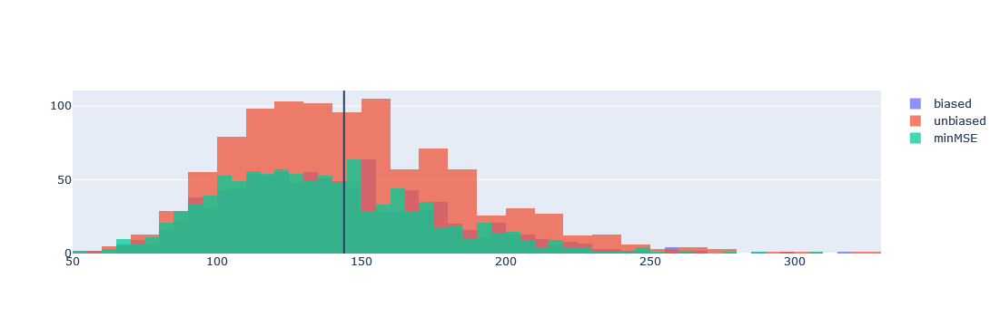

In [9]:
# code for variance
fig = go.Figure()
fig.add_trace(go.Histogram(x=biased,  name='biased' ))
fig.add_trace(go.Histogram(x=unbiased,  name='unbiased'))
fig.add_trace(go.Histogram(x=minMSE,  name='minMSE'))
# Overlay the histograms
fig.update_layout(barmode='overlay')
# Reduce opacity to see histograms
fig.update_traces(opacity=0.75)
fig.add_vline(x=true_var)
fig.show()

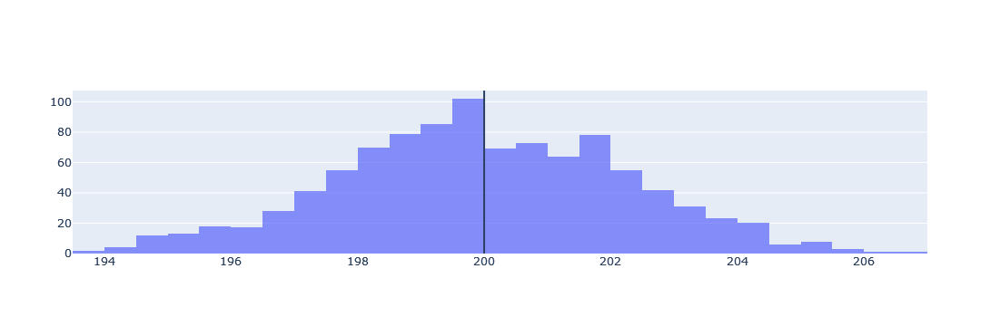

In [10]:
# code for mean
results_mean = run_experiment(samples = data, statistic = np.mean)

fig = go.Figure()
fig.add_trace(go.Histogram(x=results_mean,  name='mean' ))
# Reduce opacity to see histograms
fig.update_traces(opacity=0.75)
fig.add_vline(x=true_mu)
fig.show()

In [11]:
# code for bias
bias_mean = np.mean(np.array(results_mean)) - true_mu
print(bias_mean)
bias_unbiased = np.mean(np.array(unbiased)) - true_var
print(bias_unbiased)
bias_biased = np.mean(np.array(biased)) - true_var
print(bias_biased)
bias_minMSE = np.mean(np.array(minMSE)) - true_var
print(bias_minMSE)

-0.033285828586940625
1.9541099828788902
-2.9110270165503778
-7.462284209564871


In [12]:
# code for MSE
MSE_mean = np.mean((true_mu - np.array(results_mean))**2)
print(MSE_mean)
MSE_unbiased = np.mean((true_var - np.array(unbiased))**2)
print(MSE_unbiased)
MSE_biased = np.mean((true_var - np.array(biased))**2)
print(MSE_biased)
MSE_minMSE = np.mean((true_var - np.array(minMSE))**2)
print(MSE_minMSE)

5.176049231636305
1582.6233491117725
1483.7794555844403
1437.3452481259017


**Exercise 2. (optional)**  In the previous exercise, we worked with the distribution of the estimators by running multiple experiments with a given sample size (by default quite small). In this exercise, we will analyze the asymptotic properties of the estimators. To this end:

* Compute 100 samples of each size from 2 to 5000 (you may keep using data from N(200,144)). For each sample compute:

 - $\hat{X} = \frac{1}{n} \sum_{i=1}^n X_i$ as a mean estimator
 - $\hat{X} +10$ as a mean estimator
 - unbiased estimator for variance $\tilde{S}_n^2 = \frac{1}{n-1} \sum_{i=1}^n (X_i-\hat{X})^2$
 - biased estimator for variance $S_n^2 = \frac{1}{n} \sum_{i=1}^n (X_i-\hat{X})^2$

* Scatterplot the obtained values of the parameters against the sample size: y axis should the the value of the parameter, and x axis should be the size of the sample. Add a horizontal line with the true value of the parameter. Compare the plots. Do values of the estimators become closer to real values when the size of the sample increases? Do the results agree with the results on consistency of the estimators? Discuss.

* Compute the biases of the estimators. Plot the biases of the estimators against the sample size. Add a horizontal line in zero. Compare the insights from the plots with the theory of asymptotical unbiasedness.

Hint: We encourage you to use scatterplots, but visualizations of distributions may also come in handy.

**Solution of Exercise 2**

In [13]:
def mean_biased(sample : np.array) -> float:
    return np.mean(sample) + 10

In [14]:
max_sample_size = 5000
# For faster computations; should be set to 1 for exact solution
step = 100

sample_sizes = list(range(2,max_sample_size+1,step))

mean_unb = []
mean_b = []
var_unb = []
var_b = []

for sample_size in sample_sizes:
    
    samples = make_dataset(mu=true_mu, std_dev=true_stddev, N=100, sample_size=sample_size)

    mean_unb.append([np.mean(sample) for sample in samples])
    mean_b.append([mean_biased(sample) for sample in samples])
    var_unb.append([var_unbiased(sample) for sample in samples])
    var_b.append([var_ML(sample) for sample in samples])

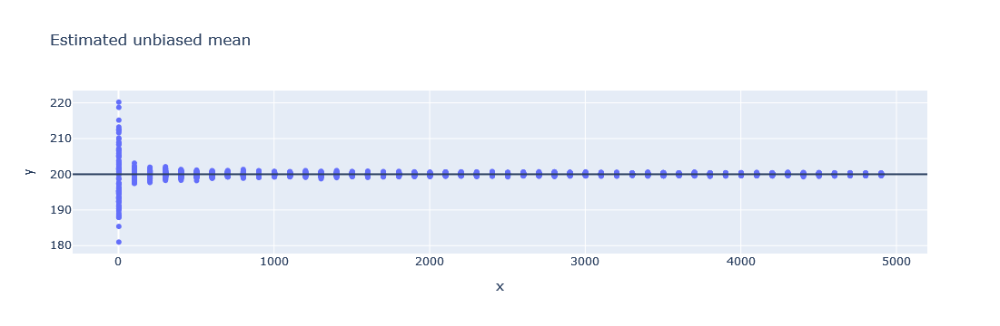

In [15]:
from itertools import repeat

fig = px.scatter(x=list(repeat(2,100)), y=mean_unb[0], title='Estimated unbiased mean')
for ind in range(1,len(sample_sizes)):
    fig.add_trace(go.Scatter(x=list(repeat(sample_sizes[ind],100)), y=mean_unb[ind], mode='markers',
                             marker=dict(color=fig.data[0].marker.color)))

fig.add_hline(y=true_mu)
fig.update_layout(showlegend=False)
fig.show()

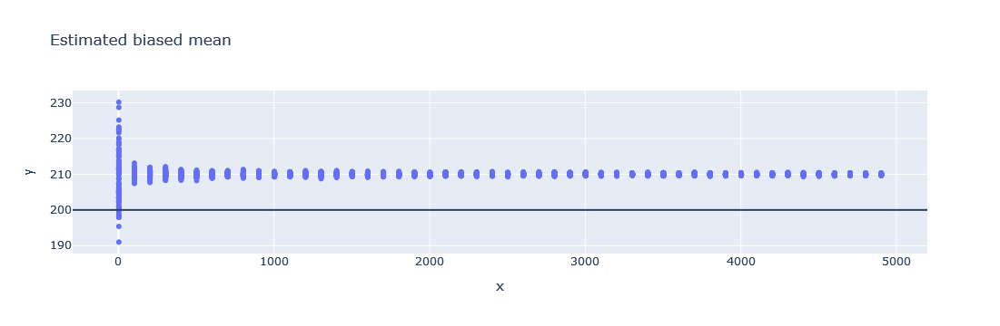

In [16]:
fig = px.scatter(x=list(repeat(2,100)), y=mean_b[0], title='Estimated biased mean')
for ind in range(1,len(sample_sizes)):
    fig.add_trace(go.Scatter(x=list(repeat(sample_sizes[ind],100)), y=mean_b[ind], mode='markers',
                            marker=dict(color=fig.data[0].marker.color)))

fig.add_hline(y=true_mu)
fig.update_layout(showlegend=False)
fig.show()

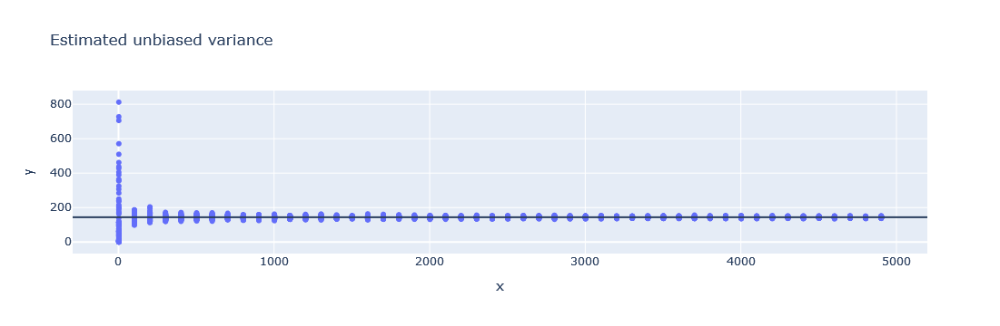

In [17]:
fig = px.scatter(x=list(repeat(2,100)), y=var_unb[0], title='Estimated unbiased variance')
for ind in range(1,len(sample_sizes)):
    fig.add_trace(go.Scatter(x=list(repeat(sample_sizes[ind],100)), y=var_unb[ind], mode='markers',
                            marker=dict(color=fig.data[0].marker.color)))

fig.add_hline(y=true_var)
fig.update_layout(showlegend=False)
fig.show()

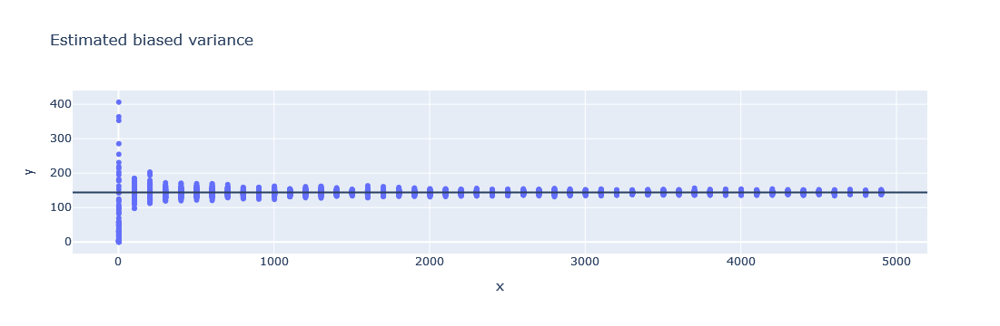

In [18]:
fig = px.scatter(x=list(repeat(2,100)), y=var_b[0], title='Estimated biased variance')
for ind in range(1,len(sample_sizes)):
    fig.add_trace(go.Scatter(x=list(repeat(sample_sizes[ind],100)), y=var_b[ind], mode='markers',
                            marker=dict(color=fig.data[0].marker.color)))

fig.add_hline(y=true_var)
fig.update_layout(showlegend=False)
fig.show()

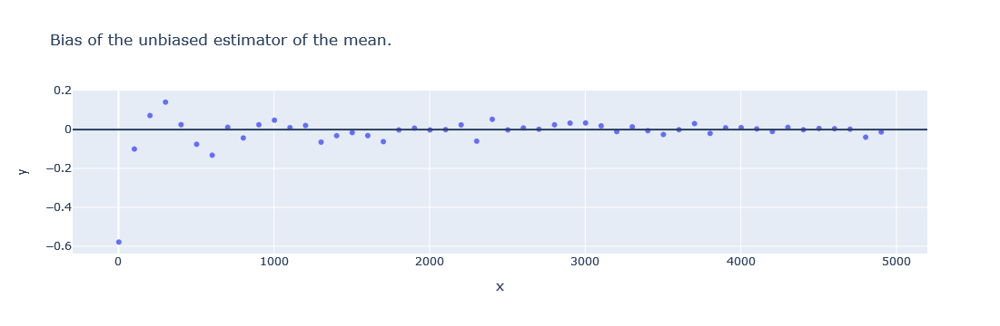

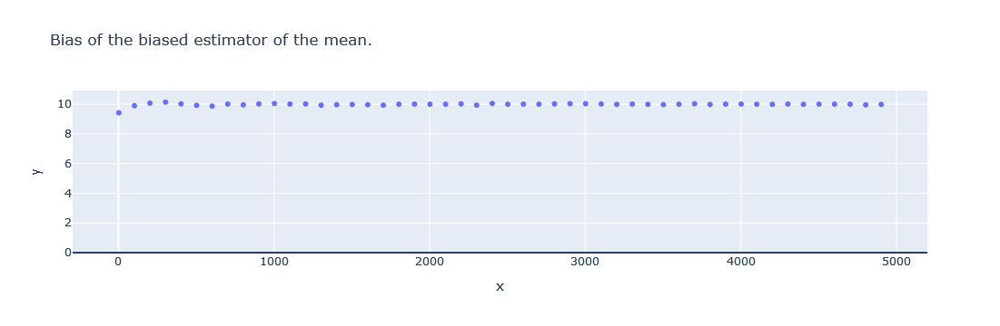

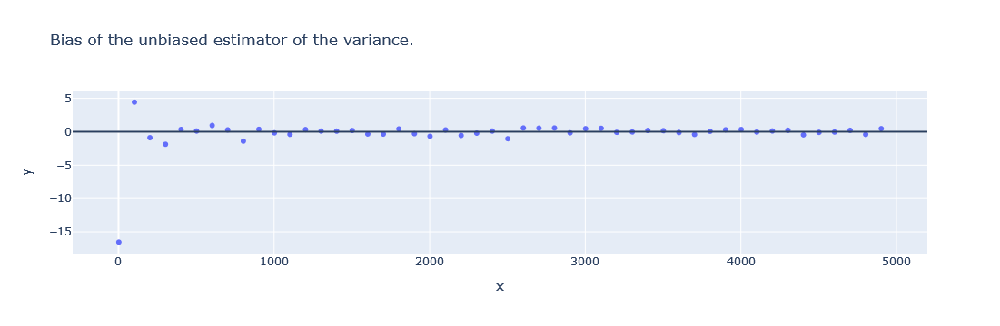

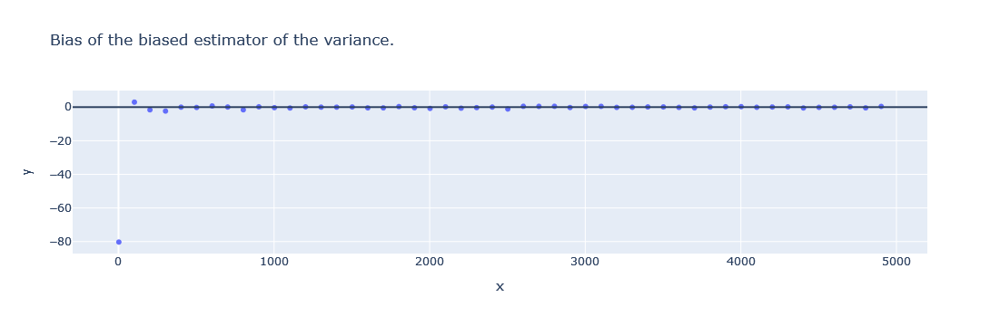

In [19]:
bias_mean_unb = [np.mean(estimations) - true_mu for estimations in mean_unb]
fig = px.scatter(x=sample_sizes, y=bias_mean_unb, title='Bias of the unbiased estimator of the mean.')
fig.add_hline(y=0)
fig.show()

bias_mean_b = [np.mean(estimations) - true_mu for estimations in mean_b]
fig = px.scatter(x=sample_sizes, y=bias_mean_b, title='Bias of the biased estimator of the mean.')
fig.add_hline(y=0)
fig.show()

bias_var_unb = [np.mean(estimations) - true_var for estimations in var_unb]
fig = px.scatter(x=sample_sizes, y=bias_var_unb, title='Bias of the unbiased estimator of the variance.')
fig.add_hline(y=0)
fig.show()

# The difference can be better seen with sample sizes in the range [2,100].
bias_var_b = [np.mean(estimations) - true_var for estimations in var_b]
fig = px.scatter(x=sample_sizes, y=bias_var_b, title='Bias of the biased estimator of the variance.')
fig.add_hline(y=0)
fig.show()

**Exercise 3 -- optional homework.** Find an MLE estimator for $\lambda$ in exponential distribution (probability density function  $f(x) = \lambda \exp(-\lambda x)$ for $x \in [0, \infty)$), using pen and paper.
Prepare a similar analysis of the properties of the found estimator as the analyses in Exercise 1 and 2 (analysis of the distribution with a given sample size and the analysis of the asymptotical properties based on the increasing sample sizes). You may assume true $\lambda = 2$. Discuss your results.

## Exploratory analysis
The first step to any statistical analysis is to explore the data - check the basic statistics like the mean and variance, and visualize the data to see what kind of distribution we're dealing with.

**Exercise 4.** In this exercise, we'll extract the data about human proteins, perform a simple data transformation, and do a basic exploratory analysis.

1. Select the data about human protein lengths from the `protein_lengths` data frame, and put it into a data frame `human_protein_lengths`. Here, you may need to use the `.copy()` method for the subsequent steps to work (ask your tutor if you need a further explanation).
2. Calculate the base-10 logarithm of the protein length and append it to the `human_protein_lengths` data frame as a column called `LogLength`.
3. Use the `human_protein_lengths.describe()` method to check the basic statistics of the numerical columns of the data frame. What is the average length of a human protein? What is the maximum length?  
4. Use the `px.histogram()` functions to create histograms showing the distributions of the protein lengths and log-lengths. Which distribution is more spread around its average? Does any distribution resemble the Normal (Gaussian) distribution? Are there many proteins with lengths similar to the maximum length, or just a few?  
5. Calculate the average length and log-length and their standard deviations; Store them in variables `true_mean`, `true_mean_log`, `true_std` and `true_std_log`. We'll use them in subsequent exercises as our *ground truth* against which we'll evaluate our estimators.     

*Quick question*. Is $\text{true_mean}$ equal to $10^\text{true_mean_log}$? Why/why not? (note that we've used the base-10 logarithm)

*Why the base-10 logarithm?* Mathematicians usually prefer to use the natural logarithms. In statistical data analysis, we sometimes use also the base-10 logarithms, because their values are easier to interpret as orders of magnitude (or simply the numbers of digits) of our values. Although the logarithms are mostly equivalent mathematically, an easier interpretation is important to get more meaningful conclusions from the data.

*Why the standard deviation?* Some students may wonder why we prefer the standard deviation rather than the variance - after all, the difference is just a square root, so mathematically it's almost the same thing. Here, again, the reason is the interpretability of the results. When we compute the variance, we square the observations. As a consequence, their units also get squared. This means that, if we estimate the number of mushrooms in a forest, the variance is expressed in terms of *mushrooms squared*, which doesn't make any sense. Taking a square root brings the unit back to mushrooms.   

  Scientific name Common name   Protein ID  Protein length
0    Homo sapiens       Human  NP_000005.3            1474
1    Homo sapiens       Human  NP_000006.2             290
2    Homo sapiens       Human  NP_000007.1             421
3    Homo sapiens       Human  NP_000008.1             412
4    Homo sapiens       Human  NP_000009.1             655
       Protein length      LogLength
count   136193.000000  136193.000000
mean       692.655775       2.711540
std        746.993628       0.329892
min         12.000000       1.079181
25%        316.000000       2.499687
50%        514.000000       2.710963
75%        842.000000       2.925312
max      35991.000000       4.556194


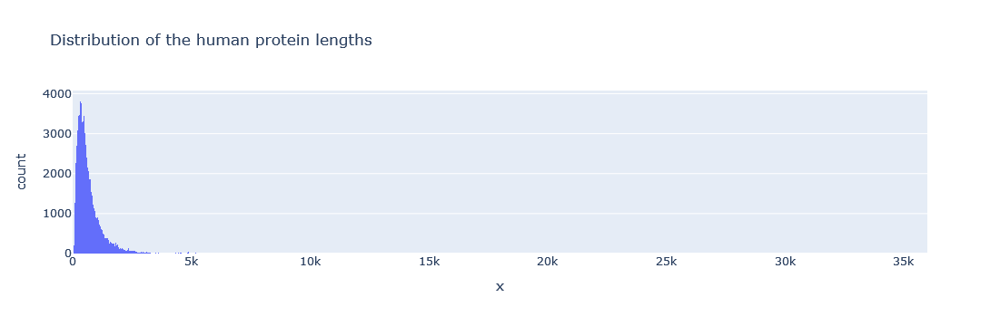

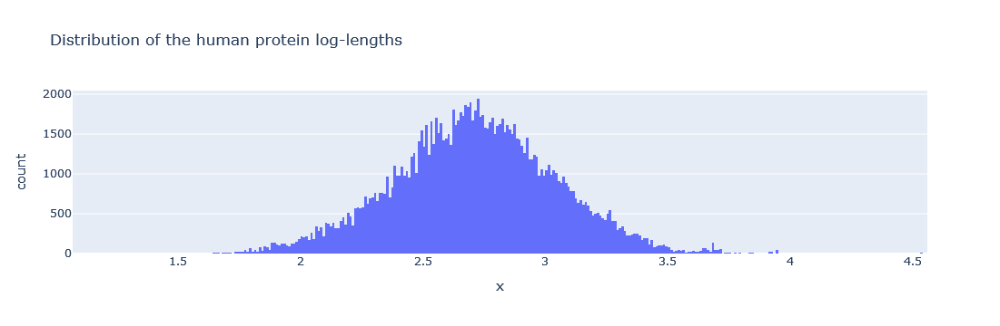

In [3]:
human_protein_lengths = protein_lengths.loc[protein_lengths['Common name'] == 'Human'].copy()
# Note: without .copy(), some versions of Pandas may return a View.
# This may interfere with adding a new column to human_protein_lengths.
print(human_protein_lengths.head())

human_protein_lengths['LogLength'] = np.log10(human_protein_lengths['Protein length'])

print(human_protein_lengths.describe())

fig = px.histogram(x=human_protein_lengths['Protein length'], title="Distribution of the human protein lengths")
fig.show()
fig = px.histogram(x=human_protein_lengths['LogLength'], title="Distribution of the human protein log-lengths")
fig.show()



true_mean = human_protein_lengths['Protein length'].mean()
true_mean_log = human_protein_lengths['LogLength'].mean()
true_std = human_protein_lengths['Protein length'].std()
true_std_log = human_protein_lengths['LogLength'].std()

## Point estimation

One of the main strengths of statistical theory is that it allows us to estimate many quantities (like the mean protein length, mean income in a country, or voting preferences)  using only a sample of randomly selected observations, and, most importantly, to estimate the uncertainty of such estimation. This is the main reason why we derive properties of estimators, such as their expected value and variance. Good statisticians can derive estimators which need less observations and give better results.   

**Exercise 5.** In this exercise, we'll do an empirical analysis of the properties of the estimator of the mean. We'll use a sample of $N=1000$ randomly selected human proteins. Denote $X_i$ as the length of a randomly selected human protein, and $\log(X_i)$ as its base-10 logarithm. Define the following two estimators:

$$\hat{\mu}_X = \sum_{i=1}^N X_i/N, \text{an estimator of the mean length}$$

$$\hat{\mu}_{\log(X)} = \sum_{i=1}^N \log(X_i)/N, \text{an estimator of the mean log-length}$$  

First, we'll draw $R=2000$ independent samples and calculate the estimators. Here's an example way to do this:   

1. Create empty lists called e.g. `means` and `means_log`.  
2. Repeat the following $R$ times (e.g. using a `for` loop):  
    2.1. Get a random sample of size $N$ of the observations (i.e. rows) from `human_protein_lengths`; you can use the `.sample()` method.   
    2.2. Calculate the mean length and append to `means`  
    2.3. Calculate the mean log-length and append to `means_log`.     
3. Convert both lists to `numpy` arrays (e.g. `means = np.array(means)`)

Now, we can inspect how well the estimators approximate the *true* mean length $\mu_X$ and the *true* mean log-length $\mu_{\log{X}}$ (notice the lack of hats above $\mu$'s - this means that these are the true parameters, not estimators).

4. Estimate the mean value of the estimator of the mean (by running `np.mean(means)`). Is it close to the true value $\mu$? In other words, does the estimator seem *unbiased*?
5. Estimate the bias of the estimator of the mean log-length (using the values in `means_log`). Does it seem biased? Does the result agree with the theoretical one about the estimator of the mean?       
5. Estimate the Root Mean Square Error of the estimator of the mean, defined as $\text{RMSE}(\hat{\mu}_X) = \sqrt{\mathbb{E}(\hat{\mu}_X - \mu_X)^2}$. This will tell you, approximately, the average error of $\hat{\mu}_X$ in terms of the number of amino acids (the building blocks of proteins). Why did I write *approximately*? (Hint: it's not just becasue we estimate it rather than calculate it theoretically)
6. Estimate $\text{RMSE}(\hat{\mu}_{\log(X)})$. How can you interpret the result?
7. Estimate the standard deviations of the estimators. Which one is less variable? Does it mean that one quantity is easier to estimate than the other?
8. Is $\text{sd}(\hat{\mu}_X) = \text{RMSE}(\hat{\mu}_X)$? Why/why not? Is the equation always true, sometimes true, or never true?    


**Solution of Exercise 5**

In [5]:
## Part 1
N = 1000  # Sample size
R = 2000  # Number of replications
means = []
means_log = []
for i in range(R):
  sample = human_protein_lengths.sample(N)
  means.append(sample['Protein length'].mean())
  means_log.append(sample['LogLength'].mean())
means = np.array(means)
means_log = np.array(means_log)

In [8]:
## Part 2
print()
print('Symmetry of the distributions of the estimators:')
print('Fraction of estimates over the true mean of lengths:', np.mean(means > true_mean))
print('Fraction of estimates over the true mean of log-lengths:', np.mean(means_log > true_mean_log))
print()
print('Means of the estimators:')
print('Mean for mean length:', np.mean(means))
print('Mean for mean log-length:', np.mean(means_log))
print()
print('Bias of the estimators:')
print('Bias for mean length:', np.mean(means - true_mean))
print('Bias for mean log-length:', np.mean(means_log - true_mean_log))
print()
print('RMSE of the estimators:')
print('RMSE for mean length:', np.sqrt(np.mean((means - true_mean)**2)))
print('RMSE for mean length:', np.sqrt(np.mean((means_log - true_mean_log)**2)))
print()
print('Variability of the estimators:')
print('SD for mean length:', np.std(means))
print('SD for mean log-length:', np.std(means_log))


Symmetry of the distributions of the estimators:
Fraction of estimates over the true mean of lengths: 0.472
Fraction of estimates over the true mean of log-lengths: 0.4885

Means of the estimators:
Mean for mean length: 692.2747585
Mean for mean log-length: 2.7115341630008465

Bias of the estimators:
Bias for mean length: -0.38101676010884017
Bias for mean log-length: -5.472058766885723e-06

RMSE of the estimators:
RMSE for mean length: 22.45216856634703
RMSE for mean length: 0.010008887033946237

Variability of the estimators:
SD for mean length: 22.448935376987876
SD for mean log-length: 0.010008885538104128


**Exercise 6.** The standard deviation of an unbiased estimator tells us how much it fluctuates around the true value. An estimator with a lower standard deviation will more often give us values that are close to the true one. This way, we can compare two estimators of the same thing.  

However, the standard deviation is often not that useful when comparing the measurements of two different things. This is because it depends on the units of the measurement. Suppose we measure the length $L$ of some objects in meters, and the standard deviation of the measurement is $\text{sd}(L)$. Measuring the same object in centimeters will give us a measurement equal $100L$, and the corresponding standard deviation $\text{sd}(100L) = 100\text{sd}(L)$ will appear to be much larger, but it doesn't mean that measurements in centimeters are more difficult. To make matters worse, in real-life applications, the variability of the measurement often depends on its average value, regardless of the units. The standard deviation of the height of a mouse (a few milimeters) is much lower than the one of an elephant (several centimeters), but it doesn't mean that mice are easier to measure. Similarly, in the case of protein length and log-length, the latter is much smaller, so it can be expected that its standard deviation will be smaller as well.

To evaluate the variability of an estimator regardless of its units and the average value, we can calculate a so-called [*coefficient of variation*](https://en.wikipedia.org/wiki/Coefficient_of_variation) (variation, not variance!). For a random value $Y$, this is defined as $\text{cv}(Y) = \text{sd}(Y)/\mathbb{E}(Y)$.   

7. Calculate the coefficients of variation for the estimators of mean protein length, i.e. $\text{cv}(\hat{\mu}_X)$, and log-length, i.e. $\text{cv}(\hat{\mu}_{\log(X)})$. Which estimator is better in this case? In general, does a lower coefficient of variation always mean that an estimator is better?
8. Is $\text{cv}(Y)$ always equal to  $\text{sd}(Y/\mathbb{E}(Y))$? Is there a condition for $Y$ that makes it equal? Give an analytical argument and verify that empirically on the protein length data.





**Solution of Exercise 6**

Ad. 7: Not if the estimator is biased.  

Ad. 8: This works for $\mathbb{E}(Y)>0$, because $\text{sd}(cY) = |c|\text{sd}(Y)$. Some people define $\text{cv}(Y) = \text{sd}(Y)/|\mathbb{E}(Y)|$, then the equation always holds.

In [9]:
print()
print('Coefficient of variation of the estimators:')
print('CV for mean length:', np.std(means)/np.mean(means))
print('CV for mean log-length:', np.std(means_log)/np.mean(means_log))
print()
print('Coefficient of variation of the estimators, method 2:')
# Yup, it's that simple - we just change the location of one bracket.
# But in more advanced applications it's worth to realize and remember this property of the std.
print('CV for mean length:', np.std(means/np.mean(means)))
print('CV for mean log-length:', np.std(means_log/np.mean(means_log)))
print()
print('Relative RMSE of the estimators:')
print('Relative RMSE for mean length:', np.sqrt(np.mean((means - true_mean)**2))/true_mean)
print('Relative RMSE for mean length:', np.sqrt(np.mean((means_log - true_mean_log)**2))/true_mean_log)


Coefficient of variation of the estimators:
CV for mean length: 0.032427782612830705
CV for mean log-length: 0.0036912260500628637

Coefficient of variation of the estimators, method 2:
CV for mean length: 0.03242778261283071
CV for mean log-length: 0.0036912260500628655

Relative RMSE of the estimators:
Relative RMSE for mean length: 0.03241461252223834
Relative RMSE for mean length: 0.0036912191525926897


**Exercise 7.** Remember that the estimators are random variables with their own distributions! We can explore their distributions visually.  

4. Use the `px.histogram()` function to generate histograms of the estimator of the mean $\hat{\mu}_X$ and the log-mean $\hat{\mu}_{\log(X)}$.
5. Annotate the histograms with the true values $\mu_X$ and $\mu_{\log{X}}$ that you have computed in Exercise 1. You can do the annotation any way you want, I typically use a red dot at the bottom of the histogram or a vertical line. Are the estimators centered around the true values? Which estimator is more focused (i.e. less spread) around the true value?
6. Annotate the histograms with the average values of the estimators that you have computed in Exercise 3. Use different colors than in the previous point.
7. Is the distribution of the estimator $\hat{\mu}_{\log(X)}$ similar to the distribution of the protein log-lengths that you visualized in Exercise 1?
6. Is the distribution of the estimator $\hat{\mu}_X$ similar to the distribution of the protein lengths that you visualized in Exercise 1? Or maybe it's more similar to the normal distribution now? Why?


**Solution of Exercise 7**

Ad. 8: Because of the Central Limit Theorem, the distribution of the empirical mean converges to the Normal distribution (convergence in law) for large samples. The sample size N=1000 is so large that the convergence is almost full.

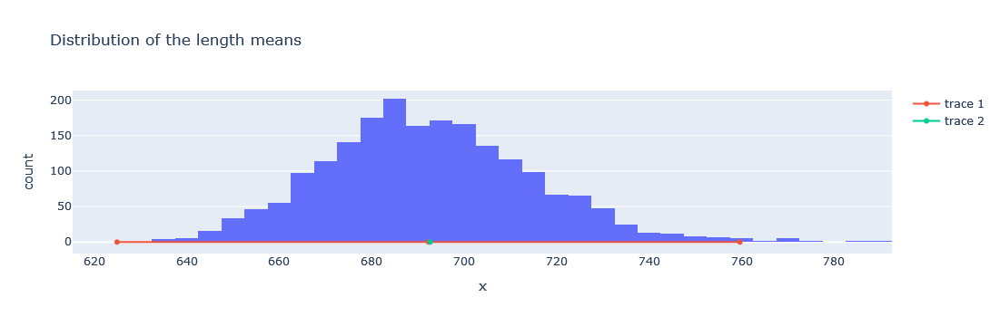

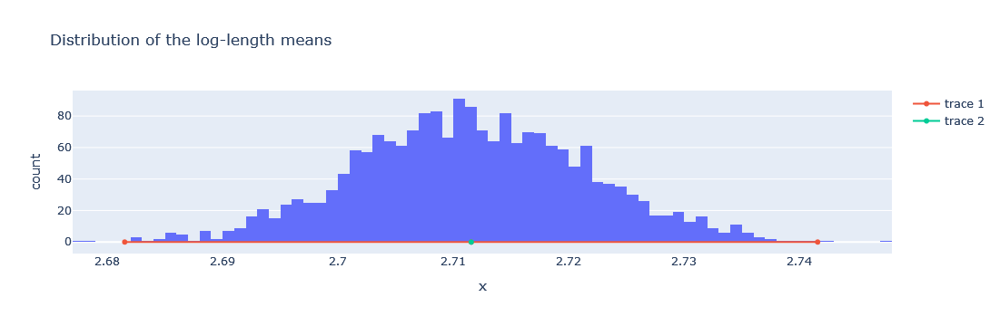

In [10]:
fig = px.histogram(x=means, title="Distribution of the length means")
fig.add_scatter(x=[np.mean(means) - 3*np.std(means), np.mean(means), np.mean(means) + 3*np.std(means)], y=[0, 0, 0], text=['Mean of means'])
fig.add_scatter(x=[true_mean], y=[0], text=['True mean'])
fig.show()
fig = px.histogram(x=means_log, title="Distribution of the log-length means")
fig.add_scatter(x=[np.mean(means_log) - 3*np.std(means_log), np.mean(means_log), np.mean(means_log) + 3*np.std(means_log)], y=[0, 0, 0], text=['Mean of means'])
fig.add_scatter(x=[true_mean_log], y=[0], text=['True mean'])
fig.show()



**Exercise 8.** We've learned how to analyze the properties of an estimator for a fixed sample size $N$, and we can use this knowledge to do something even more useful: determining how many observations we need for an estimation with a given precision.

1. Using the equations for the expected value and the standard deviation of the estimator of the mean, $\hat{\mu}_X = \sum_{i=1}^N X_i/N$ where $X_i$ is the length of a randomly selected protein, calculate the sample size $N^*$ that we need to take in order for the standard deviation of the estimator to be equal to a fraction $p$ of the true mean (i.e. $\sigma_\hat{\mu} = p\mu$; note the lack of a hat above sigma - it's not a random variable, but a parameter of the estimator). Express it in terms of coefficients of variability. You will need to assume that the standard deviation of the protein length is known; use the value in the `true_std` variable from Exercise 1.
2. Calculate $N^*$ for the estimator of the average log-length (use the true standard deviation of protein log-lengths in the `true_std_log` variable). Is there a noticeable difference compared to the estimator of the average length? Which quantity is easier to estimate?   
2. Analyze one of the estimators for a sample of size of the corresponding $N^*$: visualize its distribution, estimate its bias, standard deviation, coefficient of variation and RMSE. You can simply modify the code from the previous exercises.   
  2.1 Use the results to verify if your calculation of $N^*$ was correct.  
  2.2 How did the distribution of the estimator change compared to the previous sample size ($N = 1000$)?  
3. *Quick question 1*. Does $N^*$ depend on the number of proteins that humans have? In order to get the same precision of the estimation (measured in terms of the RMSE), would you need a larger sample size if humans had a million proteins?  
4. *Quick question 2.* Does $N^*$ depend on the distribution of the data?


*Note.* In practice, the estimation of $N^*$ is often more difficult, because we usually don't know the true standard deviation; instead, we need to estimate it and take into account the error of this estimation when deriving $N^*$. Because of this, the required sample size will typically be larger than in the case of a known standard deviation. This topic is too complex to cover in this course, so we'll focus on the simpler case with a known standard deviation.


**Solution of Exercise 8**

*Derivation of the sample size.* From the definition of $\hat{\mu}_X$ we have
$$\mathbb{E}\hat{\mu}_X = \mathbb{E}X = \mu.$$
If $X$ is the length of a randomly selected human protein from our data set, then $\mu$ is exactly equal to the mean computed from the data frame `true_mean` (the mean of all the values is not an estimator in this case, but a parameter).  
When $X_i$ are independent random variables, we also have
$$\sigma^2_\hat{\mu} = \mathbb{V} \hat{\mu} = \frac{1}{N} \mathbb{V} X = \frac{\sigma_X^2}{N}$$
Again, $\sigma_X$ is exactly equal to the standard deviation of the length of all human proteins. Note that this formula only works for *independent* random variables. This assumption is not exactly true if we sample without replacement (sampling one income changes the set of incomes that we can sample in the next step), but since the population size is large and the sample size is much smaller, it has a negligible influence.

Combining the two equations (and noting that $p = \text{cv}_\hat{\mu}$) we get:
$$\sigma_\hat{\mu} = p \mu \Leftrightarrow N = (\frac{\sigma_X}{p\mu_X})^2 = \frac{\text{cv}_X^2}{\text{cv}_{\hat{\mu}}^2}$$

Ad 5. We would typically say that $N^*$ depends on the parameters of the distribution (its mean and sd), but it doesn't depend on the distribution itself (whether it's normal, log-normal, gamma etc.).  

In [18]:
## Get the desired sample size:
true_cv_length = true_std/true_mean
true_cv_loglength = true_std_log/true_mean_log
target_estimator_cv = 0.01
target_N_mean = int(true_cv_length**2/(target_estimator_cv**2))
target_N_mean_log = int(true_cv_loglength**2/(target_estimator_cv**2))
print('Required number of observations for estimator\'s CV equal', target_estimator_cv, ':')
print('For protein length:', target_N_mean)
print('For protein log-length:', target_N_mean_log)

Required number of observations for estimator's CV equal 0.01 :
For protein length: 11630
For protein log-length: 148


The estimated mean and sd of the estimator of the mean for the calculated sample size:
2.711729458500217 0.02749563296477168
The estimated CV of the estimator of the mean for the calculated sample size:
0.01013951922032029


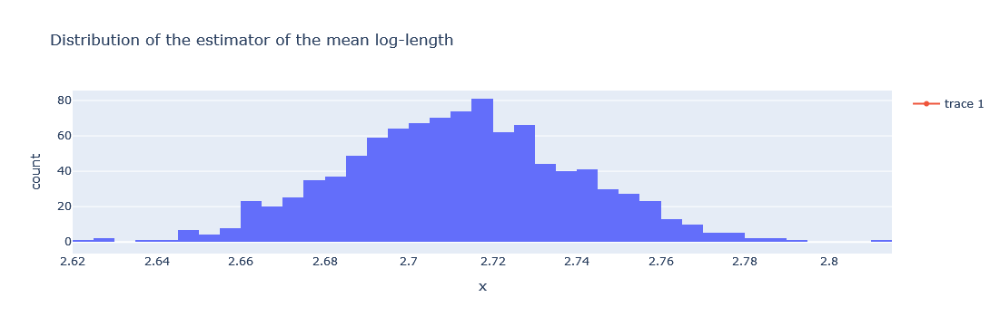

In [19]:
## Get 1000 values of the estimator:
means_log_Nstar = []
for i in range(1000):
  sample = human_protein_lengths.sample(target_N_mean_log)
  means_log_Nstar.append(np.mean(sample['LogLength']))
means_log_Nstar = np.array(means_log_Nstar)
print('The estimated mean and sd of the estimator of the mean for the calculated sample size:')
print(np.mean(means_log_Nstar), np.std(means_log_Nstar))
print('The estimated CV of the estimator of the mean for the calculated sample size:')
print(np.std(means_log_Nstar)/np.mean(means_log_Nstar))
## Create the histogram:
fig = px.histogram(x=means_log_Nstar, title="Distribution of the estimator of the mean log-length")
fig.add_scatter(x=[means_log_Nstar], y=[0])

**Exercise 9.** Can we use the estimated average log-length to estimate the average length of human proteins?  

1. Consider a statistic given by the equation $\hat{\zeta} = 10^{\hat{\mu}_{\log(X)}}$. Is it an estimator of the average income?  
  1.1 Does $\hat{\zeta}$ correspond to some well-known mathematical object, e.g. some kind of mean?
2. Regardless of the answer, let's try to use $\hat{\zeta}$ to estimate the average protein length. Use the randomly sampled values of $\hat{\mu}_{\log(X)}$ from the previous exercises to calculate the corresponding values of $\hat{\zeta}$ and to estimate this estimator's expected value and standard deviation. You can use a sample size of your choice; try to compare the results for different sample sizes, like $N = 10, 100, 1000$.  
3. Based on the results, do you think that $\hat{\zeta}$ is an unbiased estimator of the average length? Try to confirm your expectations by deriving formulas for the expected value of $\hat{\zeta}$.  
  3.1.\* If $\hat{\zeta}$ is biased, then how does the bias scale with the number of observations? Check this either theoretically by analyzing equations or empirically by estimating the bias for different sample sizes (e.g. create a plot showing the estimated bias depending on the sample size).   
4. Does $\hat{\zeta}$ have a lower or a higher variance than $\hat{\mu}_{X}$? What about the coefficient of variability?   
5. Plot the values of the estimators $\hat{\zeta}$ and $\hat{\mu}_I$ on two boxplots side-by-side and annotate it with the true average income (for example, using a horizontal line). Which estimator seems better?  
6. Which estimator has a lower RMSE: $\hat{\zeta}$ or $\hat{\mu}_X$? Why?  
7.\* Do we have $\text{RMSE}(\hat{\zeta}) \geq \text{RMSE}(\hat{\mu}_X)$ for all sample sizes? If not, then try to characterize the sample sizes for which  $\hat{\zeta}$ works better than $\hat{\mu}_X$.  



**Solution of Exercise 9**

Ad. 1. An estimator of a parameter is any statistic that we use to estimate it, so whether $\hat{\zeta}$ is an estimator of the income depends on how we *use* it, not how we *define* it.  
$\hat{\zeta}$ is equal to a geometric mean of the incomes.  

Ad. 3, 4: *Bias and variance.* We have

$$\mathbb{E}\hat{\zeta} = \mathbb{E} \prod_i X_i^{1/N} = \prod_i \mathbb{E}  X_i^{1/N} = (\mathbb{E} X_1^{1/N})^N $$
Using the Jensen's inequality, Holder's inequality we get

$$\mathbb{E}\hat{\zeta} = (\mathbb{E} X_1^{1/N})^N \leq \mathbb{E} X_1 = \mu,$$

with equality only when $X_1$ is constant.
We can also show the bias by using the inequality of the means:

$$\hat{\zeta} = (\prod_i X_i)^{1/N} \leq \sum_i X_i / N = \hat{\mu}_X.$$

This also shows that $\hat{\zeta} \leq \hat{\mu}_I$ (i.e. on any sample, $\hat{\zeta}$ will give a lower or equal value than $\hat{\mu}$; note that it's an inequality of random variables, not just their expectations).  

To get the mean squared error, we can either compute it directly by comparing the sampled values of $\hat{\mu}_X$ to $\mu$, or by using the fact that, for any estimator, we have $MSE(\hat{\mu}) = \mathbb{V}\hat{\mu} + \text{bias}(\hat{\mu})^2$. This also explains why $\hat{\zeta}$ has a lower RMSE than $\hat{\mu}_X$ on small sample sizes (e.g. N=10): it has some bias, but also a lower variance. Note that you may need to sample many values of the estimator to see this (I've used 10 000). On larger sample sizes (e.g. N=100) the variance of $\hat{\mu}_X$ gets small enough that it wins with $\hat{\zeta}$.  


Zeta is always less than Mu on the same sample: True
True mean: 692.6557752601088
Mean, standard deviation and CV of the geometric mean (zeta):
531.3561779711758 129.82686158017188 0.24433114163813208
Mean, standard deviation and CV of the arithmetic mean (mu):
695.68975 240.7927943355812 0.3461209459181786


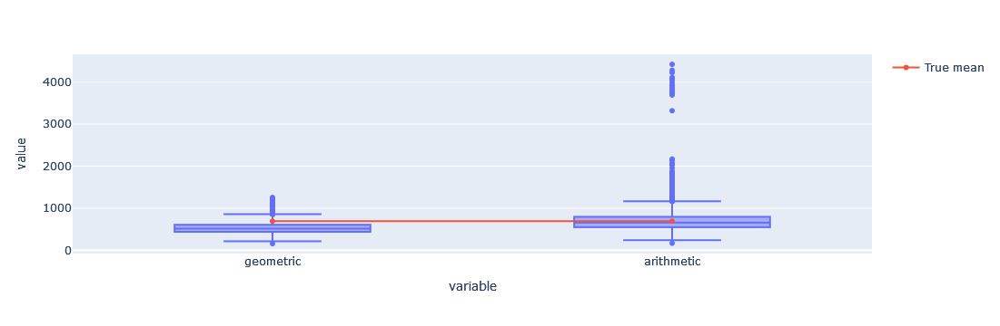

RMSE of the arithmetic means: 240.81190752672467
RMSE of the geometric means: 207.05693437634264
RMSE of the arithmetic means, option 2: 240.81190752672467
RMSE of the geometric means, option 2: 207.05693437634264


In [20]:
## Calculate the estimators for a given sample size
N = 10
arithmetic_means = []  # this is the same as 'means' from the previous exercises, but I renamed it for the sake of clarity
geometric_means = []
for _ in range(10000):
  sample = human_protein_lengths.sample(N)
  arithmetic_means.append(np.mean(sample['Protein length']))
  geometric_means.append(np.power(10, np.mean(sample['LogLength'])))
arithmetic_means = np.array(arithmetic_means)
geometric_means = np.array(geometric_means)

## Verify that zeta <= mu
print('Zeta is always less than Mu on the same sample:', np.all(geometric_means <= arithmetic_means))

## Check the mean value of income estimated using mean-log10:
print('True mean:', true_mean)
print('Mean, standard deviation and CV of the geometric mean (zeta):')
print(np.mean(geometric_means), np.std(geometric_means), np.std(geometric_means)/np.mean(geometric_means))
print('Mean, standard deviation and CV of the arithmetic mean (mu):')
print(np.mean(arithmetic_means), np.std(arithmetic_means), np.std(arithmetic_means)/np.mean(arithmetic_means))
## Note the bias and the divverence in std.

## Plot the boxplots:
estimators = pd.DataFrame({'geometric': geometric_means, 'arithmetic': arithmetic_means})
estimators = estimators.melt()
fig = px.box(estimators, x='variable', y='value')
fig.add_scatter(x=['geometric', 'arithmetic'], y=[true_mean, true_mean], name ='True mean')
fig.show()

## Get the MSE, option 1:
print('RMSE of the arithmetic means:', np.sqrt(np.mean((arithmetic_means-true_mean)**2)))
print('RMSE of the geometric means:',np.sqrt(np.mean((geometric_means-true_mean)**2)))
## Get the MSE, option 2:
print('RMSE of the arithmetic means, option 2:', np.sqrt(np.var(arithmetic_means) + np.mean(arithmetic_means-true_mean)**2))
print('RMSE of the geometric means, option 2:',np.sqrt(np.var(geometric_means) + np.mean(geometric_means-true_mean)**2))


## Interval estimation

In the previous section, we've learned how to quantify and analyze the uncertainty of an estimation by analyzing the standard deviation of the estimator. In this section, we will learn a different technique - the estimation of *confidence intervals*, i.e. intervals which are likely to contain the true value of the parameter of interest.

In general, we say that a confidence interval $[A, B]$ for a parameter $\theta$ has a confidence level $\alpha$ if it contains the true value of the parameter $\theta$ with probability $\alpha$:

$$\mathbb{P}(A \leq \theta \leq B) = \alpha$$

Above, $A$ and $B$ are random variables calculated from the data (i.e. $A$ and $B$ are *statistics*). Note: some authors use a different terminology and would call this a level $1-\alpha$; some authors also use a more general definition with $\mathbb{P} \geq \alpha$ instead of $\mathbb{P} = \alpha$, because we often can't determine the exact probability and can only give its lower bound (you've seen this in the lecture with the Chebyshev confidence intervals).

In principle, we can construct confidence intervals for any parameter of any distribution (e.g. the expected value, the variance, the proportion in the Bernoulli distribution, the shape parameter of the Gamma distribution etc.), but this is often difficult in practice. We'll focus on confidence intervals for the true mean (i.e. the expected value) of a normally distributed population - this is one of the most commonly used and one of the most useful confidence intervals.

For the expected value of a normally distributed random variable, there are two commonly used confidence intervals: the conficence interval for a *known* $\sigma$, given by the equation

$$\left (\hat{\mu} - q_{(1+\alpha)/2}\frac{\sigma}{\sqrt{N}},\quad \hat{\mu} + q_{(1+\alpha)/2}\frac{\sigma}{\sqrt{N}} \right ), $$
where $q_{(1+\alpha)/2}$ is the quantile of the standard normal distribution at the level of $(1+\alpha)/2$; and the confidence interval for an *unknown* $\sigma$, given by the equation

$$\left (\hat{\mu} - t_{(1+\alpha)/2, N-1}\frac{\hat{\sigma}}{\sqrt{N}},\quad \hat{\mu} + t_{(1+\alpha)/2, N-1}\frac{\hat{\sigma}}{\sqrt{N}} \right ), $$
where $t{(1+\alpha)/2, N-1}$ is the quantile of the Student's $t$ distribution with $N-1$ degrees of freedom at the level of $(1+\alpha)/2$, and $\hat{\sigma}$ is the square root of the **unbiased** estimator of the variance, i.e. $\hat{\sigma} = \sqrt{\sum_{i=1}^N (X_i - \bar{X})^2/(N-1)}$, where $\bar{X} = \hat{\mu} = \sum_{i=1}^N X_i$.

If we simply plug $\hat{\sigma}$ instead of $\sigma$ in the first kind of the confidence interval (the one for a known $\sigma$), we get a third type of a confidence interval, a so-called *asymptotic confidence interval* for the mean; the name *asymptotic* comes from the fact that $\hat{\sigma} → \sigma$ as $N → ∞$. As a consequence of this convergence, the asymptotic confidence interval gives quite accurate results for large sample sizes.  

**Exercise 10.** In this exercise, we'll do an empirical comparison of the properties of the three types of confidence intervals using the protein log-length data. We'll sample $R$ samples of some size $N$, calculate the corresponding confidence intervals for the mean, and check whether they have the desired confidence level and compare their lengths.   

First, we'll prepare our data.    
1. Create empty lists (or `numpy arrays`) that will contain the information whether the true mean is within a confidence interval (e.g. `within_normal` for the confidence interval with a known $\sigma$, `within_student` for the confidence interval with an unknown $\sigma$, `witin_asymptotic` for the asymptotic confidence interval).   
2. Create empty lists (or `numpy arrays`) that will contain the lengths of the intervals.    
3. Repeat the following $R=1000$ times (or more):  
  3.1. Select a random sample of size $N$ of protein log-lengths; select $N$ of your choice.   
  3.2. Calculate the three confidence intervals on the confidence level 95%. For the quantiles, you can use the `norm.ppf` and `t.ppf` functions from the `scipy.stats` package. For the normal confidence interval, use the known standard deviation in `true_mean_log`. Pay attention to the type of the estimator of standard deviation that you use! Some packages use the unbiased estimator of the variance, some don't!  
  3.3. Calculate the lengths of the confidence intevals and append them to the corresponding lists.
  3.4. Check whether the confidence intervals contain the true average log-length $\mu_{\log(X)}$, append the information to the corresponding lists.  

Now, we'll use the generated data to analyze the properties of the confidence intervals.

4. For each type of the confidence interval, estimate the probability that it contains $\mu_{\log(X)}$. Is the estimated probability close to the desired confidence level for each type? Why/why not? Does the answer depend on $N$?  
5. Calculate the average length of each type of the confidence interval. Which type tends to give the shortest intervals? Which type tends to give the longest? Why?    
6. Plot histograms depicting the distribution of the lengths of the confidence intervals.
7. What are the advantages and disadvantages of each type of the confidence interval? Does the asymptotic confidence interval have any advantages over the other two?   
8. *Quick question.* For a single sample, do all of the three types of confidence intervals always contain $\hat{\mu}_{\log(X)}$?  

Repeat this exericise using the protein lengths instead of log-lengths. What went wrong and why? Does the answer depend on $N$?      


**Solution of Exercise 10**

Ad. 4. For the Gaussian and Student confidence intervals the estimated probability should be very close to the expected confidence level, because the data is (almost) normally distributed, and we have a theoretical proof of their correctness. The asymptotic confidence interval is correct only approximately, and we don't have a theoretical guarantee that it will actually have the desired level of confidence, especially for small samples. The estimated probability should be very close to the desired confidence level for moderate and large samples ($N>100$), but slightly below it for small samples (e.g. for $N=20$ I get around 0.94).

Ad. 5. The confidence interval should be the shortest for the Gaussian and the asymptotic types; in fact, those two types should have very similar lengths, especially on the average. This is because they are both derived under the assumption of a known $\sigma$, which allows for a more precise estimation. The Student confidence interval takes into account the uncertainty of the estimation of $\sigma$, and, accordingly, returns a wider confidence interval (one can also say that we're less confident in our estimation of $\mu$ because we have randomness in both $\hat{\mu}$ and $\hat{\sigma}$). In general, the more "expert knowledge" we put in our model (like the knowledge about the exact value of $\sigma$), the more precise results we can get; this phenomenon will also show up later, when we deal with hypothesis testing.  

Ad. 7. The advantage of the Gaussian confidence interval is that it's shorter, and its disadvantage is that we need to know $\sigma$; it's the other way around for the Student interval. The "advantage" of the asymptotic interval is that it's shorter (because we pretend we know $\sigma$), but its disadvantage is that it misses the true $\mu$ more often (because we don't actually know $\sigma$). It's a kind of a funny tradeoff where we get a higher precision, but a lower accuracy. All the three types of confidence intervals should give approximately identical results for $N > 100$.  

Ad. 8. Yes, they're all symmetrical around $\hat{\mu} = \bar{X}$.

For protein lengths and small sample sizes everything should go completely wrong, because the data is not normally distributed. For large sample sizes it starts working again due to the Central Limit Theorem, which makes $\hat{\mu}$ normally distributed.  

Estimated confidence levels:
Gaussian confidence interval: 0.95
Student confidence interval: 0.95
Asymptotic confidence interval: 0.8635

Average lengths:
Gaussian confidence interval: 0.5783161326793647
Student confidence interval: 0.7797948412229516
Asymptotic confidence interval: 0.5504772276123325


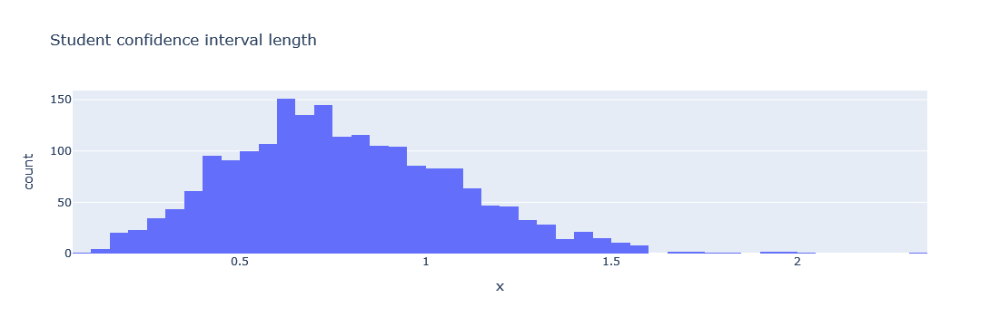

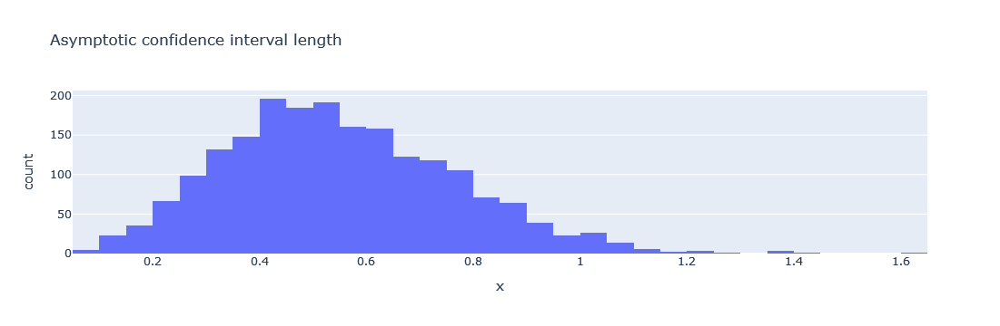

In [15]:
# Setting parameters
alpha = 0.95
R = 2000
N = 5
sqrtN = np.sqrt(N)
q = norm.ppf((1+alpha)/2)
t = tstud.ppf((1+alpha)/2, N-1)

# Generating the data
normal_radius = q*true_std_log/sqrtN  # this is non-random; chage here to "true std" for protein lengths
within_normal = []
within_student = []
within_asymptotic = []
length_student = []
length_asymptotic = []
for _ in range(R):
  sample = human_protein_lengths['LogLength'].sample(N)  # change here to 'Protein length' for protein lengths
  mdiff = abs(sample.mean() - true_mean_log)  # change here to "true mean" for protein lengths
  std_log = sample.std() # pandas uses the N-1 normalization

  student_radius = t*std_log/sqrtN
  asymptotic_radius = q*std_log/sqrtN

  length_student.append(2*student_radius)
  length_asymptotic.append(2*asymptotic_radius)

  within_normal.append(mdiff <= normal_radius)
  within_student.append(mdiff <= student_radius)
  within_asymptotic.append(mdiff <= asymptotic_radius)

# Analyze the confidence intervals
print('Estimated confidence levels:')
print('Gaussian confidence interval:', np.mean(within_normal))
print('Student confidence interval:', np.mean(within_student))
print('Asymptotic confidence interval:', np.mean(within_asymptotic))
print()
print('Average lengths:')
print('Gaussian confidence interval:', 2*normal_radius)
print('Student confidence interval:', np.mean(length_student))
print('Asymptotic confidence interval:', np.mean(length_asymptotic))

px.histogram(x=length_student, title="Student confidence interval length").show()
px.histogram(x=length_asymptotic, title="Asymptotic confidence interval length").show()



**Exercise 11.** The length of the confidence interval is another (and more common) way to determine the required sample size. In this exercise, we'll see how to use it. As in exercise 6, we'll focus on the case of a known standard deviation.  

1. Using the formula for the confidence interval with a known standard deviation, derive a formula for a necessary sample size $N^*$ such that the length of the confidence interval is at most some value $l$.  
2. Calculate the required sample size for the average log-length for $l = 0.3$ (approximately 10% of the true mean).   
3. Select a sample of the size calculated in the previous point and calculate an example confidence interval. Check if its length really is at most $l$.  
  3.1. *Quick question 1.* Is the length of this confidence interval a random variable? Does it depend on the random sample?     
4. *Quick question 2.* Do your calculations work for protein lengths as well?  
5. Take a look at the formula for the confidence interval for an unknown standard deviation. Can you see why it may be difficult to derive a formula for $N^*$ in this case?  
  5.1.\* How would you approach calculating $N^*$ in this case?     

**Solution of Exercise 11**

Answer to 1): We need to solve $2q_{(1+\alpha)/2} \sigma/\sqrt{N^*} = l$, this gives us $N^* = 4q_{(1+\alpha)/2}^2\sigma^2/l^2$.

Answer to 3.1): No. The length is given by
$$q_{(1+\alpha)/2}\frac{\sigma}{\sqrt{N}},$$
where $\sigma$ is the true, known value of the standard deviation.

Answer to 4): They don't work for small samples, which is the use case for this kind of equation, so it basically doesn't work at all.   

Answer to 5): Because we'd need to invert the Student's t distribution quantile function.

Answer to 5.1): This can be done numerically.

In [ ]:
## Get the number of samples so that the length of the confidence interval
## is equal to 0.1 of the true mean:
c = 0.1
N = int(4*q**2*true_std_log**2/(c**2*true_mean_log**2))+1.
print('We need', N, 'samples for a confidence interval of length at most', c*true_mean_log)
sample = human_protein_lengths['LogLength'].sample(N)
mu = np.mean(sample)
s = np.std(sample)
conf = [mu - q/np.sqrt(N)*true_std_log, mu + q/np.sqrt(N)*true_std_log]
print('Example confidence interval from', N, 'samples:', conf)
print('Actual length:', conf[1]-conf[0])  # this is independent
conf_asymptotic = [mu - q/np.sqrt(N)*s, mu + q/np.sqrt(N)*s]
print('Example asymptotic confidence interval from', N, 'samples:', conf_asymptotic)
print('Length of the corresponding asymptotic confidence interval:', conf_asymptotic[1] - conf_asymptotic[0])

**Exercise 12.\*** In this exercise, we'll see how the three types of the confidence intervals for the mean change with the sample size $N$. We'll also see some more details about their variability. We'll work on the protein log-length data.     

1. Create variables to store the lower and upper bounds of each of the three types of the confidence intervals for the mean on a selected confidence level.
2. For each value of $N$ from 3 to 100:  
  2.1. Draw a random sample of size $N$.  
  2.2. Calculate the three confidence intervals and store their bounds.  
3. Create line plots with $N$ on the x axis and with the lower and upper bounds of the confidence intervals on the y axis.  
  3.1.\* For best results, try to create a single plot that shows all three types of confidence intervals. Make sure that each type of a confidence interval gets assigned a single, distinct color. To do this, you may need to import additional modules from `plotly`.    
4. Annotate the plots with a horizontal line corresponding to the true mean.  
5. Based on the plots, can you describe how the length of the confidence intervals changes with an increasing sample size? (this question is about the *trend*, i.e. the average change)    
6. Which type of confidence intervals has the most variability, and which has the least? Why? (this question is about the variability *around the trend*, i.e. on top of the average change)   
7. Where can you observe the largest differences between the three types of the confidence intervals?  
8. Can you see how all the three types become more and more equivalent as the sample size grows? Why does that happen?  
9. Does increasing the sample size always result in the same increase in the precision of the estimation?  

**Solution of Exercise 12**

Ad. 5. Except for extremely small sample sizes ($N<6$), the trend is similar for all the confidence intervals and it's approximately $1/\sqrt{N}$. The length grows faster as $N$ grows smaller for the Studentized confidence interval, as expected.   

Ad. 6. For me, that's indistinguishable on the plots. In theory, the confidence interval for the known standard deviation should vary the least, because it uses only a single random value. But the difference seems barely noticeable.  

Ad. 7. For small sample sizes. For all practical purposes, for $N$ greater than 20 the three types are equivalent, and for $N$ greater than 40 they are basically identical. This is a nice illustration of why statisticians think that $21=\infty$.  

Ad. 8. The intervals converge because $\hat{\sigma} \rightarrow \sigma$ AND because the Student's t distribution converges to the Gaussian distribution.  

Ad. 9. The improvement decreases with increasing sample size; In this case, even doubling the sample size offers little benefit for $N>40$.  

In [ ]:
import plotly.graph_objects as go

alpha = 0.95
q = norm.ppf((1+alpha)/2)
N_range = (3, 101)

intervals = pd.DataFrame(data=0.,
                         index=range(*N_range),
                         columns = ['N', 'GaussL', 'GaussU', 'StudL', 'StudU', 'AsympL', 'AsympU'])
intervals['N'] = range(*N_range)
for N in range(*N_range):
  t = tstud.ppf((1+alpha)/2, N-1)
  sample = human_protein_lengths['LogLength'].sample(N)
  smean = sample.mean()
  sstd = sample.std()
  gauss_r = q*true_std_log/np.sqrt(N)
  stud_r = t*sstd/np.sqrt(N)
  asymp_r = q*sstd/np.sqrt(N)
  intervals.iloc[N-N_range[0], 1] = smean - gauss_r
  intervals.iloc[N-N_range[0], 2] = smean + gauss_r
  intervals.iloc[N-N_range[0], 3] = smean - stud_r
  intervals.iloc[N-N_range[0], 4] = smean + stud_r
  intervals.iloc[N-N_range[0], 5] = smean - asymp_r
  intervals.iloc[N-N_range[0], 6] = smean + asymp_r


fig = go.Figure()
fig.add_trace(go.Scatter(x=intervals['N'], y=intervals['GaussL'],
    fill=None,
    mode='lines',
    line_color='red',
    name='Standardized, lower'
    ))
fig.add_trace(go.Scatter(
    x=intervals['N'], y=intervals['GaussU'],
#   fill='tonexty',
    mode='lines', line_color='red',
    name='Standardized, upper'))

fig.add_trace(go.Scatter(x=intervals['N'], y=intervals['StudL'],
    fill=None,
    mode='lines',
    line_color='blue',
    name='Studentized, lower'
    ))
fig.add_trace(go.Scatter(
    x=intervals['N'], y=intervals['StudU'],
#    fill='tonexty',
    mode='lines', line_color='blue',
    name='Studentized, upper'))

fig.add_trace(go.Scatter(x=intervals['N'], y=intervals['AsympL'],
    fill=None,
    mode='lines',
    line_color='green',
    name='Asymptotic, lower'
    ))
fig.add_trace(go.Scatter(
    x=intervals['N'], y=intervals['AsympU'],
#    fill='tonexty',
    mode='lines', line_color='green',
    name='Asymptotic, upper'))

fig.add_trace(go.Scatter(
    x=N_range, y=[true_mean_log]*2,
    mode='lines', line_color='black',
    name='True mean'))

fig.add_trace(go.Scatter(
    x=list(range(*N_range)), y=true_mean_log + q*true_std_log/np.sqrt(np.array(list(range(*N_range)))),
    mode='lines', line_color='black',
    name='Trend, upper',
    opacity=0.5))

fig.add_trace(go.Scatter(
    x=list(range(*N_range)), y=true_mean_log - q*true_std_log/np.sqrt(np.array(list(range(*N_range)))),
    mode='lines', line_color='black',
    name='Trend, lower',
    opacity=0.5))

fig.show()

**Exercise 13.** A researcher has measured the blood glucose concentration (BGC) on a well-selected sample of 1000 individuals. The researcher has determined that BGC is normally distributed and that the 95% confidence interval for the average GBC is [192 mg/dl, 203 mg/dl]. Next, the researcher has run the following further studies. Evaluate whether they are correct, and if not, try to suggest corrections. Support your claims with analytical proofs or numerical simulations.

- The researcher has tested a new, experimental methodology for measuring BGC on a well-selected selected sample of another 1000 individuals. The average BGC measured this way turned out to be 205 mg/dl. The researcher has concluded that the new methodology is biased.  
- The researcher has tested a randomly selected group of 100 people who visited fast-food restaurants more than 5 times in the previous month. The confidence interval for BGC turned out to be [205 mg/dl, 210 mg/dl]. The researcher has concluded that frequently eating fast food increases the blood glucose concentration.  
- The researcher has measured BGC on another set of 1000 individuals. The 95% confidence interval for this group was equal [198 mg/dl, 208 mg/dl]. The researcher has concluded that the average BGC in the whole population is most likely within [198 mg/dl, 203 mg/dl].   

**Solution of Exercise 13**

Ad. 1. The reasoning of the researcher is as follows: the new methodology gave an average outside of the confidence interval, so it returns values which are too high. This is incorrect. A 95% confidence interval does not mean that the average value calculated on a new sample has a 95% chance of falling in it. The researcher should have calculated the confidence interval for the true average measurement returned by the new methodology. If this interval was disjoint with the original one, then we can assume that the methodology is most likely biased.  

Ad. 2. This is (mostly) correct mathematically; the average BGC of fast-food enjoyers is most likely (>95%) greater than the average BGC in the whole population. If you want to go into details here, you can discuss with the students whether the original sample should exclude fast-food enjoyers, and/or how the presence of fast-food enjoyers in the original sample influences the results. On the other hand, the scientific hypothesis itself is problematic, because "frequently eating" is a vague term; a statistician could help with formulating a more rigorous scientific hypothesis.

Ad. 3. This is incorrect. Say we have i.i.d. samples $X_1, \dots, X_{1000}$ and $Y_{1}, \dots, Y_{1000}$. Let $c = q_{(1+\alpha)/2}/\sqrt{1000}$. The confidence intervals are
$(\hat{\mu}_X - c\hat{\sigma}_X, \hat{\mu}_X + c\hat{\sigma}_X)$ and $(\hat{\mu}_Y- c\hat{\sigma}_Y, \hat{\mu}_Y + c\hat{\sigma}_Y)$, with $\hat{\mu}_X - c\hat{\sigma}_X < \hat{\mu}_Y - c\hat{\sigma}_Y < \hat{\mu}_X + c\hat{\sigma}_X < \hat{\mu}_Y + c\hat{\sigma}_Y$ (this condition comes from the way that the researcher has selected the new, "improved" confidence interval - the confidence intervals overlapped, and the researcher has selected the overlap). The probability that $\mu$ is in the "improved" confidence interval is equal to
$$\mathbb{P}(\hat{\mu}_Y - c\hat{\sigma}_Y < \mu < \hat{\mu}_X + c\hat{\sigma}_X\ |\ \hat{\mu}_X - c\hat{\sigma}_X < \hat{\mu}_Y - c\hat{\sigma}_Y < \hat{\mu}_X + c\hat{\sigma}_X < \hat{\mu}_Y + c\hat{\sigma}_Y). $$
You can go number-crunching here to calculate the probability, but I think it's clear that it doesn't have to be 95% (if you want to calculate it with the students, you may want to assume that $\sigma$ is known for simplicity and only focus on $\hat{\mu}$, because the goal here is only to show that the procedure was wrong). To correct this procedure, the researcher should calculate a single confidence interval using all the data.